# How are vaccination drives going + the inequalities underneath 

## Group members
#### Ayush Anand 19110074
#### Bhoomika Mandloi 19110076
#### Ramireddy Lakshmi Nageswari 19110097

##  Introduction

In the last two years, Covid 19 pandemic has been the cause of significant health concern over the entire globe. In such conditions, predicting trends in Covid 19 cases and analyzing patterns in spread have become tasks of utmost importance. Combining this information with the data on vaccinations around a particular country and the manufacturers of each vaccine gives us important insights into the areas that are more severely affected, the vaccines that have proved to be more effective, and show us potential next steps.

Covid-19 data is currently one of the most dynamically maintained and researched topics right now, and as such, there are various sources available to choose the data. We chose the Covid-19 data collected daily from [Our World in Data](https://ourworldindata.org/) GitHub repository for covid-19, which has been processed and narrowed down to two major files made available on [Kaggle](https://www.kaggle.com/datasets/gpreda/covid-world-vaccination-progress). The two files are [country_vaccination.csv](https://docs.google.com/spreadsheets/d/13OITB9XKcCkS5GxO9gXs7dEJpTk6Us_udOBd9dlecok/edit?usp=sharing), which contains data about the number of vaccinations carried around countrywise, and [country_vaccinations_by_manufacturers.csv](https://docs.google.com/spreadsheets/d/1qDG6D0X4X_1R7ItXYzGG_cEFxb3oHGj7X0xGFI-UOck/edit?usp=sharing), which has important data about the manufacturers of a particular vaccine. 

In [1]:
import plotly
plotly.offline.init_notebook_mode()

In [2]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
%matplotlib inline
import plotly.express as px
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 12
matplotlib.rcParams['figure.facecolor'] = '#00000000'
matplotlib.rcParams['figure.figsize'] = (10, 6)
plt.rc('font', size=11)

### Reading csv files

In [3]:
df1=pd.read_csv("data\country_vaccinations.csv")

In [4]:
df2=pd.read_csv("data\country_vaccinations_by_manufacturer.csv")

### Displaying the first five columns of country vaccinations dataset

In [5]:
df1.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,34.0,"Johnson&Johnson, Oxford/AstraZeneca, Pfizer/Bi...",World Health Organization,https://covid19.who.int/


### The data (country vaccinations) contains the following information:

* Country
* Country ISO Code
* Date - date for the data entry
* Total number of vaccinations - this is the absolute number of total immunizations in the country;
* Total number of people vaccinated - a person, depending on the immunization scheme, will receive one or more (typically 2) vaccines; at a certain moment;
* Total number of people fully vaccinated - this is the number of people that received the entire set of immunization according to the immunization scheme (typically 2); 
* Daily vaccinations (raw) - for a certain data entry, the number of vaccination for that date/country;
* Daily vaccinations - for a certain data entry, the number of vaccination for that date/country;
* Total vaccinations per hundred - ratio (in percent) between vaccination number and total population up to the date in the country;
* Total number of people vaccinated per hundred - ratio (in percent) between population immunized and total population up to the date in the country;
* Total number of people fully vaccinated per hundred - ratio (in percent) between population fully immunized and total population up to the date in the country;
* Number of vaccinations per day 
* Daily vaccinations per million - ratio (in ppm) between vaccination number and total population for the current date in the country;
* Vaccines used in the country - total number of vaccines used in the country (up to date);
* Source name - source of the information;
* Source website - website of the source of information;



### Displaying the first five columns of country vaccinations by manufacturer dataset

In [6]:
df2.head()

,location,date,vaccine,total_vaccinations
0,Argentina,2020-12-29,Moderna,2
1,Argentina,2020-12-29,Oxford/AstraZeneca,3
2,Argentina,2020-12-29,Sinopharm/Beijing,1
3,Argentina,2020-12-29,Sputnik V,20481
4,Argentina,2020-12-30,Moderna,2


### The second (country vaccinations by manufacturer), contains the following columns:

* Location - country;
* Date - date;
* Vaccine - vaccine type;
* Total number of vaccinations - total number of vaccinations / current time and vaccine type.


### Some stastistics of both the files

In [7]:
df1.describe()

,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
count,4.360700e+04,4.129400e+04,3.880200e+04,3.536200e+04,8.621300e+04,43607.000000,41294.000000,38802.000000,86213.000000
mean,4.592964e+07,1.770508e+07,1.413830e+07,2.705996e+05,1.313055e+05,80.188543,40.927317,35.523243,3257.049157
std,2.246004e+08,7.078731e+07,5.713920e+07,1.212427e+06,7.682388e+05,67.913577,29.290759,28.376252,3934.312440
min,0.000000e+00,0.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000
25%,5.264100e+05,3.494642e+05,2.439622e+05,4.668000e+03,9.000000e+02,16.050000,11.370000,7.020000,636.000000
50%,3.590096e+06,2.187310e+06,1.722140e+06,2.530900e+04,7.343000e+03,67.520000,41.435000,31.750000,2050.000000
75%,1.701230e+07,9.152520e+06,7.559870e+06,1.234925e+05,4.409800e+04,132.735000,67.910000,62.080000,4682.000000
max,3.263129e+09,1.275541e+09,1.240777e+09,2.474100e+07,2.242429e+07,345.370000,124.760000,122.370000,117497.000000


In [8]:
df2.describe()

,total_vaccinations
count,3.562300e+04
mean,1.508357e+07
std,5.181768e+07
min,0.000000e+00
25%,9.777600e+04
50%,1.305506e+06
75%,7.932423e+06
max,6.005200e+08


## Through our analysis of the data, we aim to answer questions like the following:
* Which are the top 20 countries in order of the number of total vaccinations carried out?
* How does the vaccination trend in India compare to that in other important countries like Russia and China?
* Which company has sold the most number of vaccines across all countries?
* For a particular country, what fraction of people who got the first dose of the vaccine administered were able to receive the second dose as well?


### Let us try to perform the analysis for a particular country, say India




In [9]:
India_data=df1[df1["iso_code"]=="IND"]

In [10]:
India_data.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
35372,India,IND,2021-01-15,0.0,0.0,NaN,NaN,NaN,0.00,0.00,NaN,NaN,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35373,India,IND,2021-01-16,191181.0,191181.0,NaN,191181.0,191181.0,0.01,0.01,NaN,137.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35374,India,IND,2021-01-17,224301.0,224301.0,NaN,33120.0,112150.0,0.02,0.02,NaN,80.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35375,India,IND,2021-01-18,454049.0,454049.0,NaN,229748.0,151350.0,0.03,0.03,NaN,109.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35376,India,IND,2021-01-19,674835.0,674835.0,NaN,220786.0,168709.0,0.05,0.05,NaN,121.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/


In [11]:
India_data.fillna(0) #Replacing NaN values with 0

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
35372,India,IND,2021-01-15,0.000000e+00,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35373,India,IND,2021-01-16,1.911810e+05,191181.0,0.0,191181.0,191181.0,0.01,0.01,0.00,137.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35374,India,IND,2021-01-17,2.243010e+05,224301.0,0.0,33120.0,112150.0,0.02,0.02,0.00,80.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35375,India,IND,2021-01-18,4.540490e+05,454049.0,0.0,229748.0,151350.0,0.03,0.03,0.00,109.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35376,India,IND,2021-01-19,6.748350e+05,674835.0,0.0,220786.0,168709.0,0.05,0.05,0.00,121.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35806,India,IND,2022-03-25,1.826266e+09,980435665.0,824764568.0,1997100.0,2433734.0,131.06,70.36,59.19,1747.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35807,India,IND,2022-03-26,1.830285e+09,982687842.0,826360688.0,4019460.0,2830351.0,131.35,70.52,59.30,2031.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35808,India,IND,2022-03-27,1.831348e+09,983190780.0,826884564.0,1062451.0,2851859.0,131.43,70.56,59.34,2047.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/
35809,India,IND,2022-03-28,1.833040e+09,984051283.0,827610878.0,1692273.0,2736644.0,131.55,70.62,59.39,1964.0,"Covaxin, Oxford/AstraZeneca, Sputnik V",Government of India,https://dashboard.cowin.gov.in/


### The following graph shows the per day vaccinations trend in India

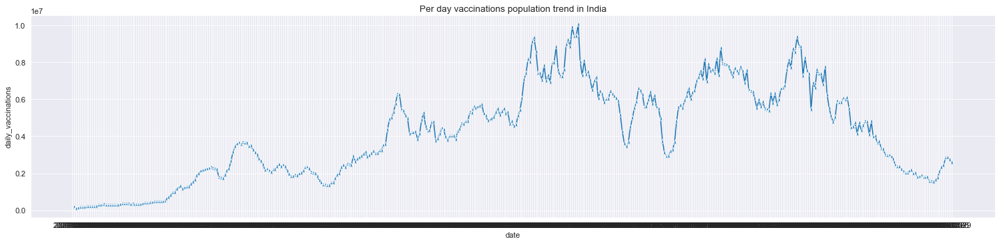

In [12]:
plt.figure(figsize=(20,5))
sns.lineplot(data=India_data,x="date",y="daily_vaccinations",marker='*',markersize= 8)
plt.title("Per day vaccinations population trend in India")

plt.tight_layout()
plt.show();


Let us now move to a trend of vaccinations over the days for different countries. We start with India, and the following plot shows the number of vaccinations carried out in India across the dates, compared with the number of vaccinations in China and Russia over the same period:


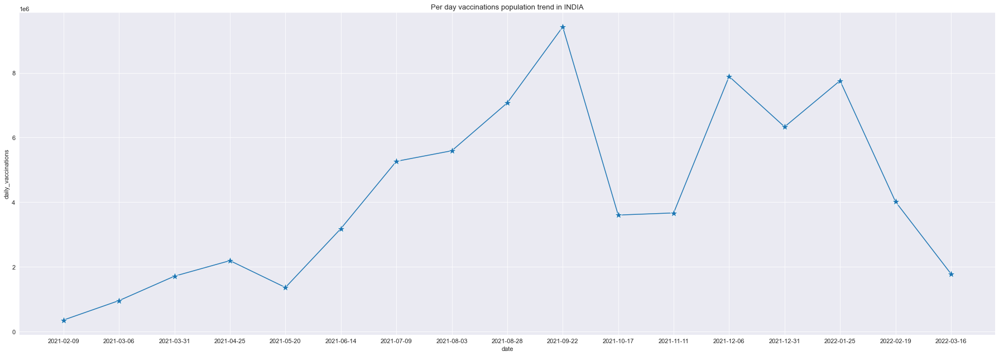

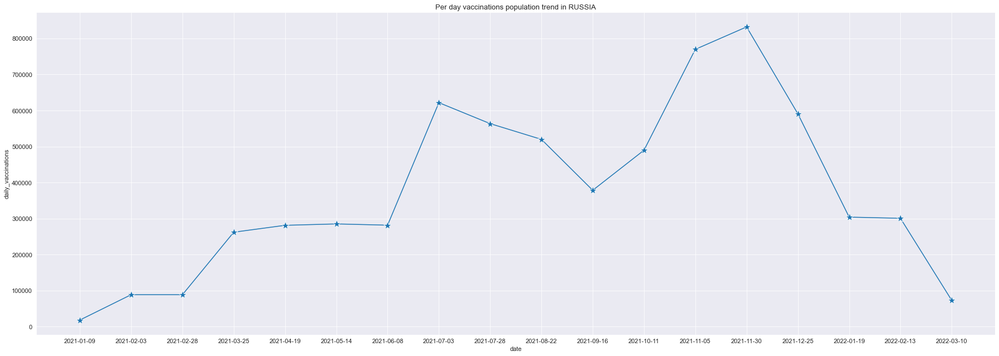

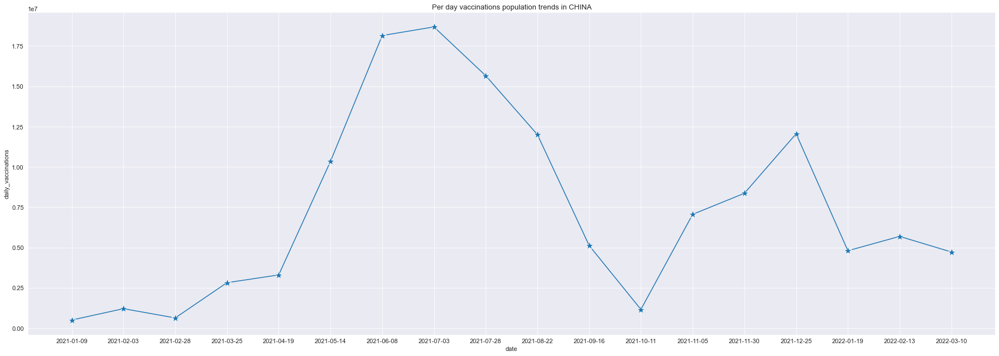

In [13]:

df4=India_data.iloc[::25][:]
df4=df4[1:][:]
df4.head()
# India_data_copy=df4[df4["iso_code"]=="IND"]
plt.figure(figsize=(25,9))
sns.lineplot(data=df4,x="date",y="daily_vaccinations",marker='*',markersize= 15)
plt.title("Per day vaccinations population trend in INDIA")

plt.tight_layout()

RUS_data=df1[df1["iso_code"]=="RUS"]
df5=RUS_data.iloc[::25][:]
df5.head()
# India_data_copy=df4[df4["iso_code"]=="IND"]
plt.figure(figsize=(25,9))
sns.lineplot(data=df5,x="date",y="daily_vaccinations",marker='*',markersize= 15)
plt.title("Per day vaccinations population trend in RUSSIA")

plt.tight_layout()

CHINA_data=df1[df1["iso_code"]=="CHN"]
df6=CHINA_data.iloc[::25][:]
# df6.head()

plt.figure(figsize=(25,9))
sns.lineplot(data=df6,x="date",y="daily_vaccinations",marker='*',markersize= 15)
plt.title("Per day vaccinations population trends in CHINA")
plt.tight_layout()
plt.show();

We see that the plots for all the three countries are very irregular, and this may depend on a number of factors like the dates around which the cases hit a peak in a particular country(corresponding to a wave); the peak of vaccination drive in that country and so on.

### Countrywise analysis of total vaccinations

Let us start with the first question. We first use a bar graph to compare the total vaccinations that have been carried out in different countries. We create the graph for the top 20 countries:

<BarContainer object of 20 artists>

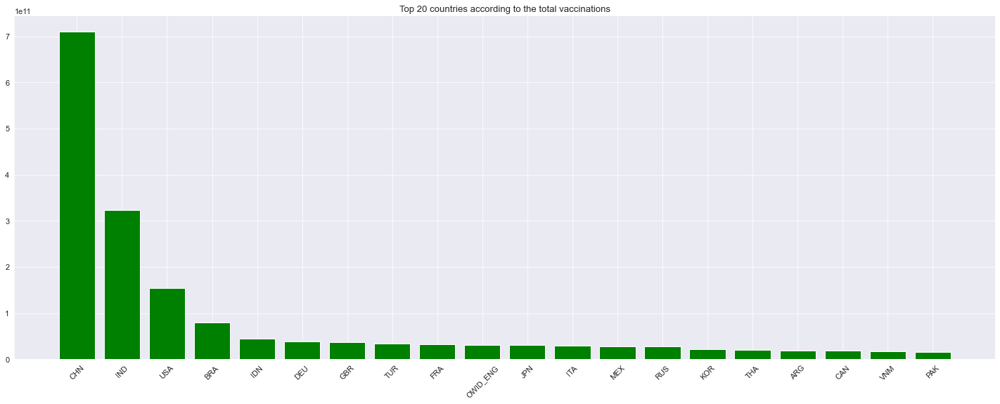

In [14]:

unique_country_codes=df1.iso_code.unique()

# print(unique_country_codes)
total_vaccinations=[]
for i in unique_country_codes:
  country_data=df1[df1["iso_code"]==i]
  total_vaccinations.append([country_data['total_vaccinations'].sum(),i])

total_vaccinations.sort(reverse=True)


plt.figure(figsize=(25,9))
plt.xticks(rotation=45)

#top 20 

countries=total_vaccinations[:20]

country_codes=[countries[i][1] for i in range(len(countries))]
vaccinated=[countries[i][0] for i in range(len(country_codes))]

# print(vaccinated)
plt.title("Top 20 countries according to the total vaccinations")
plt.bar(country_codes,vaccinated,color = 'g')

China surpasses the other countries by far in terms of the total vaccinations carried out, expected because China has the highest world population. India is the next country with the highest number of vaccines, although it is significantly lesser than China. This could be a combination of factors like the lesser population compared to China and some rural areas not receiving the vaccines in proportion to other parts of the country. The USA and Brazil are the next ones in the trend.

Since the total number of vaccines administered depends mainly on the country's population, it might not be an accurate indicator of the scale of the vaccine drive in the country. A better comparison would be the number of people vaccinated per 100 people in a particular country, and we show this trend with the help of a bar graph as well:


<BarContainer object of 20 artists>

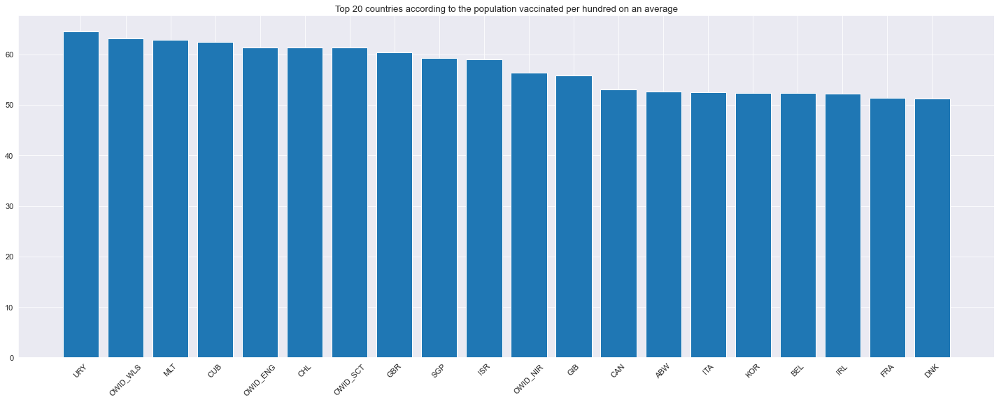

In [15]:

unique_country_codes=df1.iso_code.unique()

# print(unique_country_codes)
total_vaccinations=[]
for i in unique_country_codes:
  country_data=df1[df1["iso_code"]==i]
  total_vaccinations.append([country_data['people_vaccinated_per_hundred'].sum()/len(country_data),i])

total_vaccinations.sort(reverse=True)


plt.figure(figsize=(25,9))
plt.xticks(rotation=45)

#top 20 

countries=total_vaccinations[:20]

country_codes=[countries[i][1] for i in range(len(countries))]
vaccinated=[countries[i][0] for i in range(len(country_codes))]

# print(vaccinated)
plt.title("Top 20 countries according to the population vaccinated per hundred on an average")
plt.bar(country_codes,vaccinated)

The above graph shows a very different trend compared to the previous one. Notice how countries with a high population like China and India are way behind in the list of an average number of people vaccinated per hundred. Uruguay leads the list, with Wales and Malta following.

These trends make it painfully clear that the main story when it comes to vaccines is inequality.  According to the internet, worldwide almost 4 billion vaccine doses have been administered globally. And 27.6% of the world's population has received at least one dose of a vaccine at this point. That sounds pretty good; but when we break it down by country income groups, wealthy countries are outpacing poor nations by far. The bar plot above shows the same trend, with well developed countries like Uruguay and Wales leading the list, while countries like Burundi and Cambodia lag far behind. A recent [article](https://www.usnews.com/news/best-countries/articles/covid-19-vaccination-rates-by-country) by US News shows that this trend is still continuing, with Canada leading the list now.


223


<BarContainer object of 20 artists>

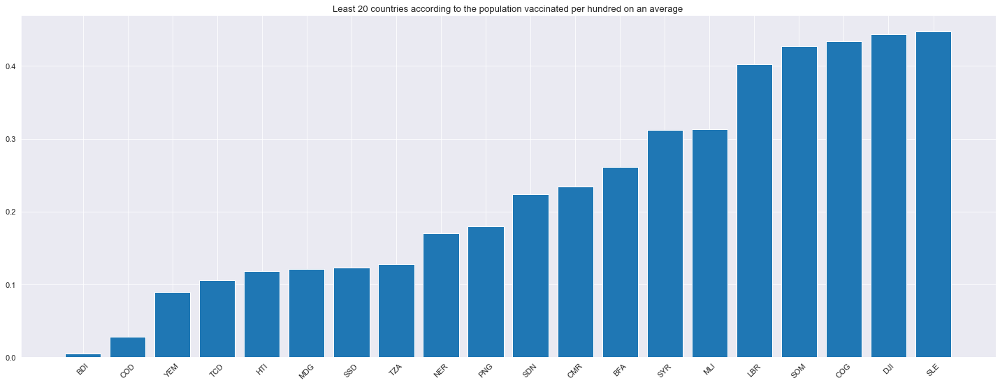

In [16]:

unique_country_codes=df1.iso_code.unique()
print(len(unique_country_codes))
# print(unique_country_codes)
total_vaccinations=[]
for i in unique_country_codes:
  country_data=df1[df1["iso_code"]==i]
  total_vaccinations.append([country_data['people_vaccinated_per_hundred'].sum()/len(country_data),i])

total_vaccinations.sort()


plt.figure(figsize=(25,9))
plt.xticks(rotation=45)

#top 20 

countries=total_vaccinations[:20]

country_codes=[countries[i][1] for i in range(len(countries))]
vaccinated=[countries[i][0] for i in range(len(country_codes))]

# print(vaccinated)
plt.title("Least 20 countries according to the population vaccinated per hundred on an average")
plt.bar(country_codes,vaccinated)

Next, we show the trend of the least 20 countries populated based on the number of vaccinations administered per hundred people of the population on average. Cambodia and Burundi are the ones with the least vaccination rate, and notice how it is orders of magnitude less as compared to the vaccination rates of Uruguay or Wales in our previous plot: 0.1 as compared to 60! The inequalities in terms of reach of vaccines stands out even more!

So, how have countries like Africa with an underdeveloped medical system coped up with the pandemic? African nations are both purchasing new doses and receiving them from other countries. Countries like India, Russia, the United Arab Emirates and China also help with their regular periodic donations. The United Nations-led COVAX initiative provided Oxford/AstraZeneca and Pfizer/BioNTech doses to some unfortunate countries around the globe. Within this program, the African continent received nearly 270 million doses as of January 2022. But this is not a win-win situation for them. Importing vaccines from other countries affects the GDP of poor countries, and numbers show that society has been substantially affected by COVID-19 in Africa, and the [number](https://www.statista.com/statistics/1221298/covid-19-vaccination-rate-in-african-countries/) of people living in extreme poverty was estimated to increase by around 30 million in 2020.

The number of people vaccinated is a fair indicator of the vaccination trend in a particular country; however there is a large difference in the number of people who get both the doses and the people who could get only the first. This could be dependent on both the second dose vaccination drive of the country and the willingness and awareness of people to show up for the second dose. The following graph shows the comparison of the number of people who got the first dose compared to the number of people who got both the doses for the top 20 countries from the last plot. Notice how the trend can be different from the above graph. India has a higher proportion of people who have got both the doses; thanks to the widespread vaccination campaign to get both the doses by our government.

[[35263365000.0, 674189298700.0, 'CHN'], [116436444996.0, 207003860802.0, 'IND'], [66636073783.0, 88377793425.0, 'USA'], [30276933880.0, 48790240515.0, 'BRA'], [2790327552.0, 15124171600.0, 'VNM'], [14031369961.0, 22820271807.0, 'GBR'], [13059057856.0, 20864043077.0, 'TUR'], [11804284068.0, 19232829955.0, 'OWID_ENG'], [16199397881.0, 22783432451.0, 'DEU'], [13032980027.0, 19144059345.0, 'FRA'], [12123170801.0, 17589883231.0, 'ITA'], [7109532830.0, 11569418458.0, 'ARG'], [8725916008.0, 13105490027.0, 'KOR'], [12126072350.0, 16258490357.0, 'RUS'], [8014596169.0, 12003758151.0, 'THA'], [7375066347.0, 10853203300.0, 'CAN'], [12534314850.0, 15981155525.0, 'MEX'], [6237563902.0, 9440322436.0, 'PAK'], [5082636380.0, 8122442034.0, 'BGD'], [13645790941.0, 16656335987.0, 'JPN']]


(0.0, 150000000000.0)

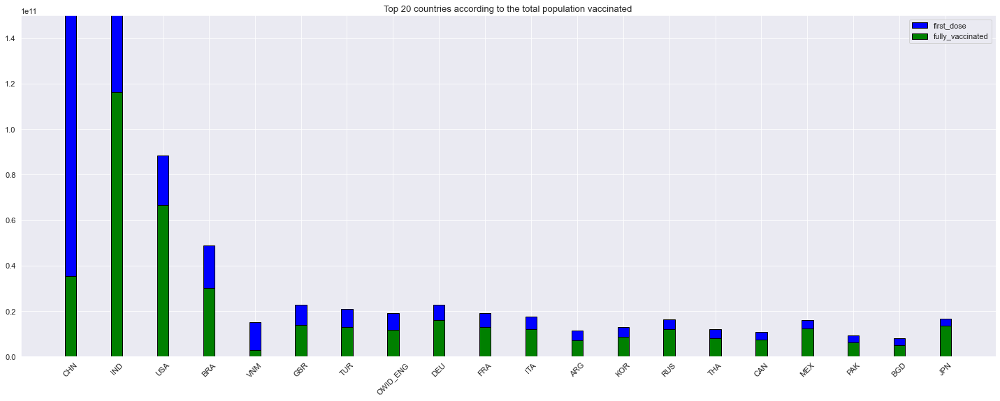

In [17]:

unique_country_codes=df1.iso_code.unique()
# print(len(unique_country_codes))
# print(unique_country_codes)
total_vaccinations=[]
for i in unique_country_codes:
  country_data=df1[df1["iso_code"]==i]
  total_vaccinations.append([country_data['people_fully_vaccinated'].sum(),country_data['total_vaccinations'].sum()-country_data['people_fully_vaccinated'].sum(),i])

total_vaccinations.sort(key=lambda x : x[1]-x[0],reverse=True)


plt.figure(figsize=(25,9))
plt.xticks(rotation=45)

#top 20 

countries=total_vaccinations[:20]
print(countries)
country_codes=[countries[i][2] for i in range(len(countries))]
first_dose_vaccinated=[countries[i][1] for i in range(len(country_codes))]
fully_vaccinated=[countries[i][0] for i in range(len(country_codes))]
# print(vaccinated)
plt.title("Top 20 countries according to the total population vaccinated")
# plt.bar(country_codes,vaccinated,color = 'g')


width = 0.25

plt.bar(country_codes, first_dose_vaccinated, color = 'b',
		width = width, edgecolor = 'black',
		label='first_dose');
plt.bar(country_codes, fully_vaccinated, color = 'g',
		width = width, edgecolor = 'black',
		label='fully_vaccinated');


plt.legend()
plt.ylim(0, 15e10)

### Analyzing the percentage of different vaccines administered throughout the world

Now, we move on to a more vaccine- manufacturers based approach towards our data analysis. We aim to find trends in which company has been the most successful in terms of vaccines sold in a particular country and all over the world. We start with a simple pie chart demonstrating the success of different vaccines all over the world( in terms of sale):

              vaccine  total_vaccinations
0             CanSino              610540
1             Covaxin                  11
2     Johnson&Johnson            18563903
3             Moderna           210341785
4             Novavax              184429
5  Oxford/AstraZeneca            67403106
6     Pfizer/BioNTech           600519998
7   Sinopharm/Beijing            28322602
8             Sinovac            25596927
9           Sputnik V            20405678


C:\Users\HP\AppData\Local\Temp/ipykernel_13528/1190577492.py:7: UserWarning:

Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access



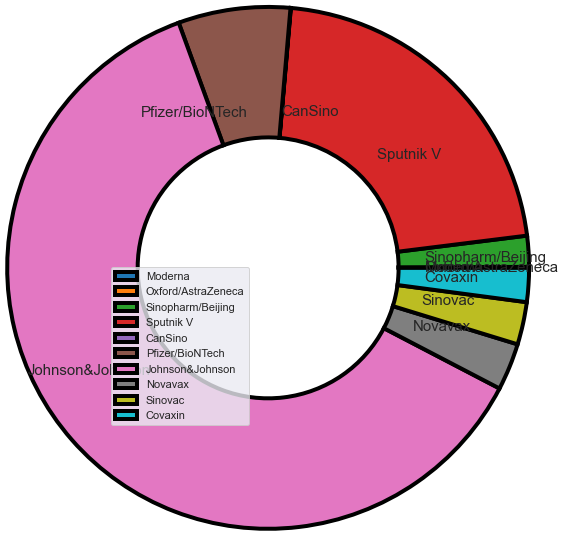

In [18]:
labels=df2.vaccine.unique()

vaccine = df2.groupby(["vaccine"])['total_vaccinations'].max().reset_index()
print(vaccine)


vaccine.percent = (vaccine.total_vaccinations/vaccine.total_vaccinations.sum())*100
# print(vaccine.percent)

wedgeprops = {"linewidth": 4, 'width':1, "edgecolor":"k"} # Width = 1
textprops = {"fontsize":15}
# plt.xticks(rotation=45);
plt.pie('total_vaccinations',labels = labels, data = vaccine,radius = 2,wedgeprops = wedgeprops,
        textprops=textprops, labeldistance = 0.6,);
plt.legend() # To show legend


The data that we have shows that Johnson&Johnson leads the list, with Russia’s Sputnik V and Pfizer to follow. We dug a little deeper into the success of J&J and why it was able to surpass the other competitors. And turns out the answer is J&J’s initiative to reduce the inequalities underneath the vaccinations carried out around the world. The following figure taken from the official website of J&J shows the distribution of participants selected for trial from different parts of the world- J&J has strived to reach everyone
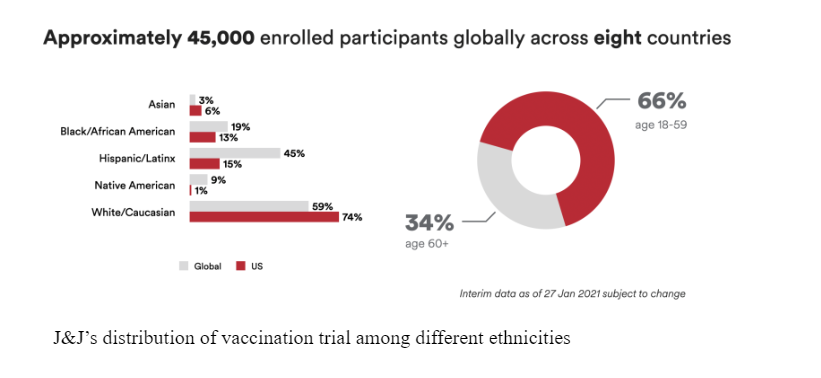



Next, let us take a look at a more country-wise approach towards distribution of different vaccines. We aim to analyze the popularity of different vaccines in different countries and form a consensus of the distribution.

In [19]:
import plotly.express as px

fig = px.choropleth(df1, locations="iso_code",
                    color="vaccines",
                    hover_name="country", 
                    color_continuous_scale=px.colors.sequential.Plasma,
                   title= "Vaccines used by different countries")



fig.update_layout(showlegend=True)
fig.show()


The above choropleth represents the spatial variations of the vaccines used by the different countries worldwide. Different colors denote different vaccines that have been used in a particular country, in accordance with the legend specified. We have also added a hover feature which allows one to observe the country name when interacting with the graph. For better visualization, we have also plotted the 3d version of it.

In [20]:
fig = px.scatter_geo(df1, locations="iso_code", color="vaccines",
                     hover_name="country",
                     projection="natural earth", template="plotly_dark")

fig.show()


We also study the different sources of obtaining the information of vaccination carried out in different countries. These consist of the government, the ministry of health, WHO, private organizations and so on. The choropleth below plots the source_name of the vaccination data for different countries denoted by different colors.


In [21]:
fig = px.choropleth(df1, locations="iso_code",
                    color="source_name",
                    hover_name="country", 
                    color_continuous_scale=px.colors.sequential.Plasma,
                   title= "Sources of information about vaccination in different countries")



fig.update_layout(showlegend=True)
fig.show()

As a concluding analysis, we visualize the trend of the total number of people vaccinated all around the globe over the period of time we have the data for. The 3d plot below shows the distribution of the number of people getting vaccinated over the days for all countries. The country name and the number of people vaccinated on a particular date can be displayed when hovered over that country.You can see the number of vaccines administered in each country on a particular date when you move the slider to tha date...

In [22]:
fig = px.scatter_geo(df1, locations="iso_code", color="people_vaccinated",
                     hover_name="country", 
                     projection="natural earth", animation_frame="date", template="plotly_dark")

fig.show()

The above data studies tell us a story: a story of the underlying inequalities in terms of vaccinations all across the globe. There is no inequality in the intensity with which Covid has hit us: it has affected everyone everywhere relentlessly. But our fight back against it has not been uniform, has it? Richer countries have fought back well because they could afford large scale vaccinations, and thus were able to return to a “new normal” much sooner as compared to the third world countries, for which the pandemic is still at large. Their economy has taken a sharp hit, and so has the quality of lifestyle. We have been helping: India, China and Russia all have taken measures to extend a helping hand to these nations, but we need to do more. It's a time when we need to unite as humans and not diverge as different countries or ethnicities, and help each other out through these challenging times. 